# **COVID-19 Visualization**

In [83]:
#Import package
import numpy as np
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt

In [26]:
#define the data path to url
url = 'https://raw.githubusercontent.com/datasets/covid-19/master/data/countries-aggregated.csv'

In [27]:
#load the data frame into data
data = pd.read_csv(url)
data.head()

,Date,Country,Confirmed,Recovered,Deaths
0,2020-01-22,Afghanistan,0,0,0
1,2020-01-23,Afghanistan,0,0,0
2,2020-01-24,Afghanistan,0,0,0
3,2020-01-25,Afghanistan,0,0,0
4,2020-01-26,Afghanistan,0,0,0


In [28]:
#display the last few rows
data.tail()

,Date,Country,Confirmed,Recovered,Deaths
161563,2022-04-12,Zimbabwe,247094,0,5460
161564,2022-04-13,Zimbabwe,247160,0,5460
161565,2022-04-14,Zimbabwe,247208,0,5462
161566,2022-04-15,Zimbabwe,247237,0,5462
161567,2022-04-16,Zimbabwe,247237,0,5462


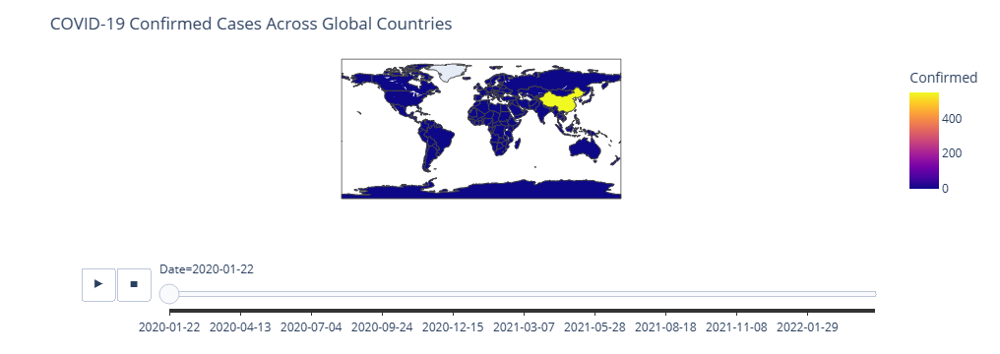

<Figure size 1000x800 with 0 Axes>

In [29]:
#create a geo visual for covid-19 confirmed cases
plt.figure(figsize=(10,8))
fig=px.choropleth(data, locations='Country', locationmode='country names', color='Confirmed', animation_frame='Date')
fig.update_layout(title_text='COVID-19 Confirmed Cases Across Global Countries')
fig.show()

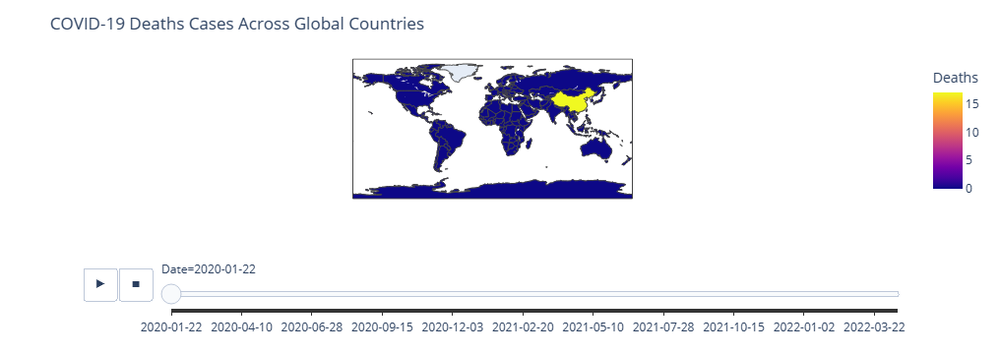

In [30]:
#create a geo visual for death cases
fig=px.choropleth(data, locations='Country', locationmode='country names', color='Deaths', animation_frame='Date')
fig.update_layout(title_text='COVID-19 Deaths Cases Across Global Countries')
fig.show()

In [31]:
df_china = data[data.Country == 'China']
df_china = df_china[['Date','Confirmed']]
df_china['Infection_rate'] = df_china['Confirmed'].diff()
df_china['Infection_rate'].max()

77402.0

In [32]:
def max_infection_rate(data, country):
    mri = []
    for c in country:
        name=data[data.Country == c]
        rate = name['Confirmed'].diff().max()
        mri.append(rate)
    data_mri = pd.DataFrame(data={'Country':country, 'Max_infection_rate':mri})
    return data_mri
        

In [33]:
#create a list of country in unique
country = list(data['Country'].unique())

#calling the function
infection = max_infection_rate(data, country)

#to identify the maximium infection affected in which country
infection.sort_values(by='Max_infection_rate',ascending=False).head(10)

,Country,Max_infection_rate
183,US,1383795.0
187,United Kingdom,848169.0
182,Turkey,823225.0
93,"Korea, South",621317.0
67,Germany,527487.0
63,France,503349.0
192,Vietnam,454212.0
80,India,414188.0
126,Netherlands,380498.0
165,Spain,372766.0


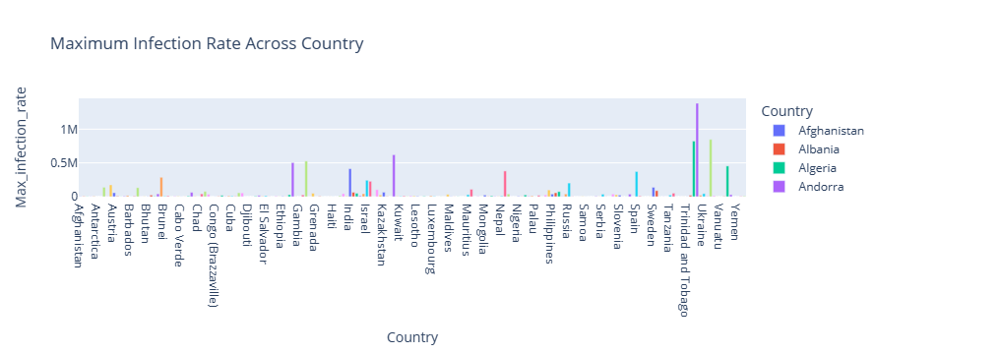

<Figure size 1000x500 with 0 Axes>

In [34]:
# plot max infection rate across all countries
plt.figure(figsize=(10,5))
fig=px.bar(infection, x='Country', y='Max_infection_rate', color='Country', title='Maximum Infection Rate Across Country')
fig.show()

## During COVID-19 Infection Rate Lockdown in India

In [35]:
def date_conversion(data, year):
    '''Used to convert the whole data frame into specific parameters as we require
    Input:
          data- dataframe
          year- int     
    Output: dataframe'''
    df=data.copy()
    import datetime as dt
    df['Date']=pd.to_datetime(df['Date'],format="%Y-%m-%d")
    df['year']=df['Date'].dt.year
    df = df[df['year']== year]
    df['Date']=df['Date'].astype('str')
    result = df.drop('year',axis=1)
    return result

In [36]:
#define the dates for lockdown
start_date = '2020-4-24'
one_month = '2020-5-24'

#calling the function
data2=data.copy()
data3=date_conversion(data2, 2020)
data3['Infection_rate']=data3.Confirmed.diff()

In [37]:
#display the information
data3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 68310 entries, 0 to 161096
Data columns (total 6 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Date            68310 non-null  object 
 1   Country         68310 non-null  object 
 2   Confirmed       68310 non-null  int64  
 3   Recovered       68310 non-null  int64  
 4   Deaths          68310 non-null  int64  
 5   Infection_rate  68309 non-null  float64
dtypes: float64(1), int64(3), object(2)
memory usage: 3.6+ MB


In [38]:
def lockdown_infection(dataset, start, one_months, country):
    ''' Calculating the Infection rate for defined country and plot the visuals 
    with some parameters like start date and certain days of lockdown'''
    
    df = dataset[dataset['Country'] == country]
    df['Infection_rate'] = df['Confirmed'].diff()
    #adding a country into title
    titles= 'Before and After Lockdown Infection Rate in '+ country
    #plot line graph
    fig = px.line(df, x='Date', y='Infection_rate', title=titles)
    #adding a line with start dates
    fig.add_shape( dict( type="line", 
                         x0=start,
                         y0=0, 
                         x1=start, 
                         y1=df['Infection_rate'].max(),
                        line=dict(color="red", width=2)))
    #adding label to the lines
    fig.add_annotation( dict( x= start, y= df['Infection_rate'].max(), text="Starting date of Lockdown"))
    #adding a line with after certain period of dates
    fig.add_shape( dict( type="line", x0=one_months,
                         y0=0, x1=one_months, y1=df['Infection_rate'].max(),
                        line= dict(color="yellow", width=2)))
     #adding label to the lines
    fig.add_annotation( dict( x= one_months, y=0, text="one Month later"))
    return df, fig.show()

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\1953854773.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



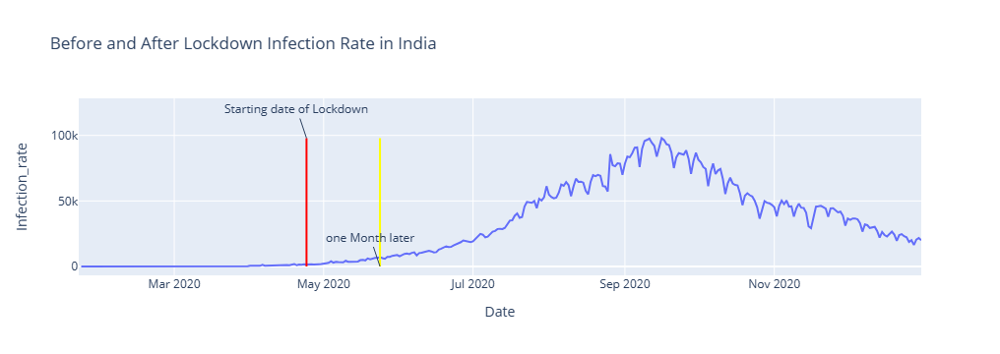

,Date,Country,Confirmed,Recovered,Deaths,Infection_rate
65280,2020-01-22,India,0,0,0,NaN
65281,2020-01-23,India,0,0,0,0.0
65282,2020-01-24,India,0,0,0,0.0
65283,2020-01-25,India,0,0,0,0.0
65284,2020-01-26,India,0,0,0,0.0


In [39]:
#calling the function
data_country, figure=lockdown_infection(data3, start_date, one_month, 'India')
data_country.head()

## During COVID-19 Death Rate Lockdown in India

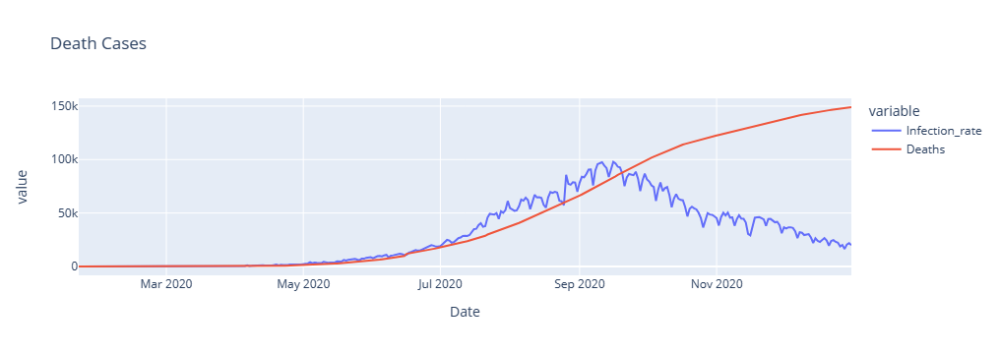

In [40]:
#plot the deaths in line chart
px.line(data_country, x='Date', y=['Infection_rate','Deaths'], title='Death Cases')

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\4003901145.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\4003901145.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\4003901145.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://panda

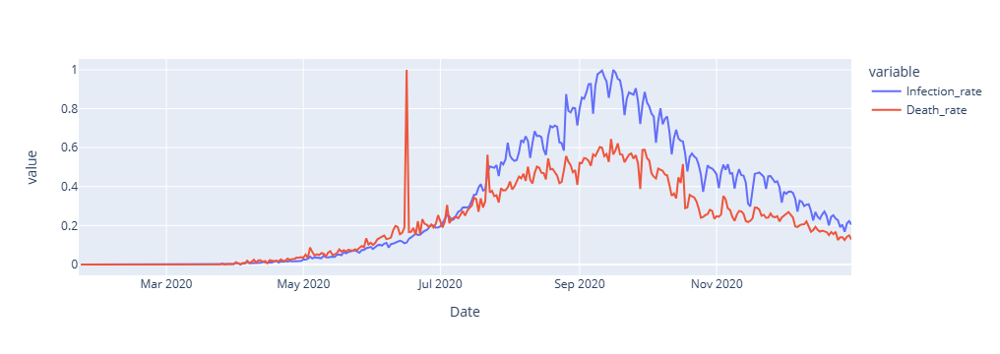

In [41]:
#calculate the death rate 
data_country['Death_rate']=data_country['Deaths'].diff()

#normalize the both columns between 0-1
data_country['Infection_rate'] = data_country['Infection_rate']/data_country['Infection_rate'].max()
data_country['Death_rate'] = data_country['Death_rate']/data_country['Death_rate'].max()

#plot the normalized data in line
px.line(data_country, x='Date', y=['Infection_rate','Death_rate'])

## During COVID-19 Infection Rate Lockdown in USA

In [42]:
def date_conversion(data, year):
    '''Used to convert the whole data frame into specific parameters as we require
    Input:
          data- dataframe
          year- int     
    Output: dataframe'''
    df=data.copy()
    import datetime as dt
    df['Date']=pd.to_datetime(df['Date'],format="%Y-%m-%d")
    df['year']=df['Date'].dt.year
    df = df[df['year']== year]
    df['Date']=df['Date'].astype('str')
    result = df.drop('year',axis=1)
    return result

In [51]:
#define the dates for lockdown
start_date = '2020-3-20'
one_month = '2020-4-20'

#calling the function
data2=data.copy()
data3=date_conversion(data2, 2020)
data3['Infection_rate']=data3.Confirmed.diff()

In [44]:
#display the information
data3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 68310 entries, 0 to 161096
Data columns (total 6 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Date            68310 non-null  object 
 1   Country         68310 non-null  object 
 2   Confirmed       68310 non-null  int64  
 3   Recovered       68310 non-null  int64  
 4   Deaths          68310 non-null  int64  
 5   Infection_rate  68309 non-null  float64
dtypes: float64(1), int64(3), object(2)
memory usage: 3.6+ MB


In [45]:
def lockdown_infection(dataset, start, one_months, country):
    ''' Calculating the Infection rate for defined country and plot the visuals 
    with some parameters like start date and certain days of lockdown'''
    
    df = dataset[dataset['Country'] == country]
    df['Infection_rate'] = df['Confirmed'].diff()
    #adding a country into title
    titles= 'Before and After Lockdown Infection Rate in '+ country
    #plot line graph
    fig = px.line(df, x='Date', y='Infection_rate', title=titles)
    #adding a line with start dates
    fig.add_shape( dict( type="line", 
                         x0=start,
                         y0=0, 
                         x1=start, 
                         y1=df['Infection_rate'].max(),
                        line=dict(color="red", width=2)))
    #adding label to the lines
    fig.add_annotation( dict( x= start, y= df['Infection_rate'].max(), text="Starting date of Lockdown"))
    #adding a line with after certain period of dates
    fig.add_shape( dict( type="line", x0=one_months,
                         y0=0, x1=one_months, y1=df['Infection_rate'].max(),
                        line= dict(color="yellow", width=2)))
     #adding label to the lines
    fig.add_annotation( dict( x= one_months, y=0, text="one Month later"))
    return df, fig.show()

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\1953854773.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



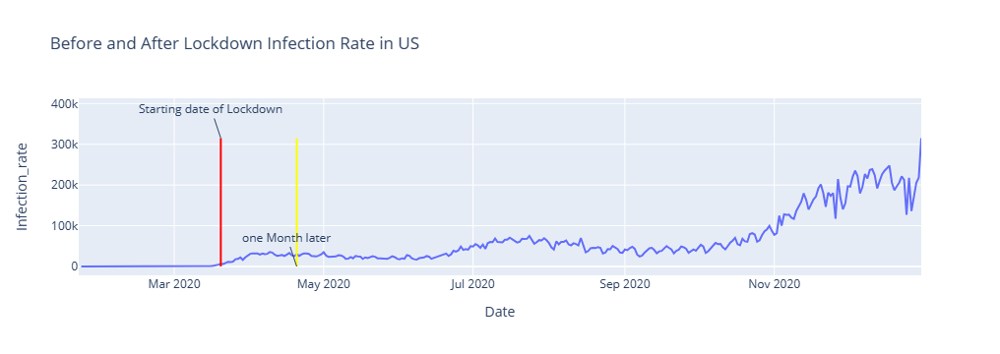

,Date,Country,Confirmed,Recovered,Deaths,Infection_rate
149328,2020-01-22,US,1,0,0,NaN
149329,2020-01-23,US,1,0,0,0.0
149330,2020-01-24,US,2,0,0,1.0
149331,2020-01-25,US,2,0,0,0.0
149332,2020-01-26,US,5,0,0,3.0


In [52]:
#calling the function
data_country, figure=lockdown_infection(data3, start_date, one_month, 'US')
data_country.head()

## During COVID-19 Death Rate Lockdown in USA

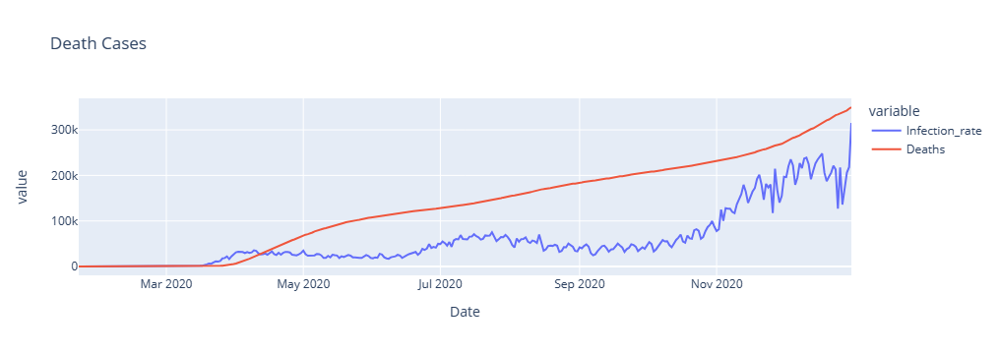

In [53]:
#plot the deaths in line chart
px.line(data_country, x='Date', y=['Infection_rate','Deaths'], title='Death Cases')

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\1023845504.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\1023845504.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\1023845504.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://panda

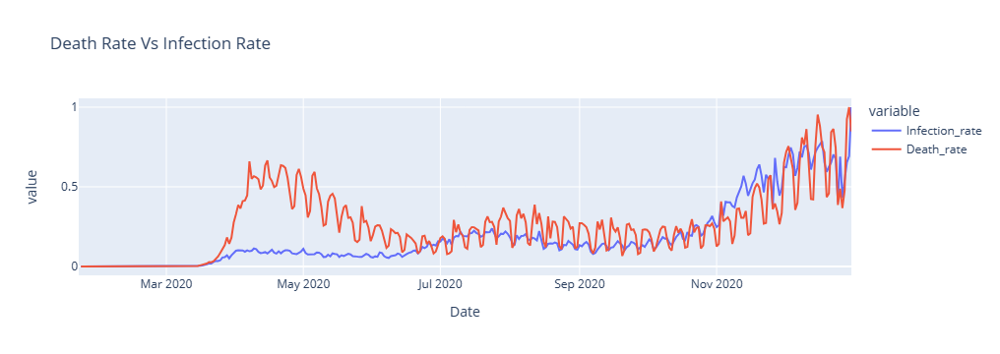

In [54]:
#calculate the death rate 
data_country['Death_rate']=data_country['Deaths'].diff()

#normalize the both columns between 0-1
data_country['Infection_rate'] = data_country['Infection_rate']/data_country['Infection_rate'].max()
data_country['Death_rate'] = data_country['Death_rate']/data_country['Death_rate'].max()

#plot the normalized data in line
px.line(data_country, x='Date', y=['Infection_rate','Death_rate'], title='Death Rate Vs Infection Rate')

## During COVID-19 Infection Rate Lockdown in Germany

In [56]:
def date_conversion(data, year):
    '''Used to convert the whole data frame into specific parameters as we require
    Input:
          data- dataframe
          year- int     
    Output: dataframe'''
    df=data.copy()
    import datetime as dt
    df['Date']=pd.to_datetime(df['Date'],format="%Y-%m-%d")
    df['year']=df['Date'].dt.year
    df = df[df['year']== year]
    df['Date']=df['Date'].astype('str')
    result = df.drop('year',axis=1)
    return result

In [55]:
#define the dates for lockdown
start_date = '2020-1-27'
one_month = '2020-2-27'

#calling the function
data2=data.copy()
data3=date_conversion(data2, 2020)
data3['Infection_rate']=data3.Confirmed.diff()

In [57]:
#display the information
data3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 68310 entries, 0 to 161096
Data columns (total 6 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Date            68310 non-null  object 
 1   Country         68310 non-null  object 
 2   Confirmed       68310 non-null  int64  
 3   Recovered       68310 non-null  int64  
 4   Deaths          68310 non-null  int64  
 5   Infection_rate  68309 non-null  float64
dtypes: float64(1), int64(3), object(2)
memory usage: 3.6+ MB


In [58]:
def lockdown_infection(dataset, start, one_months, country):
    ''' Calculating the Infection rate for defined country and plot the visuals 
    with some parameters like start date and certain days of lockdown'''
    
    df = dataset[dataset['Country'] == country]
    df['Infection_rate'] = df['Confirmed'].diff()
    #adding a country into title
    titles= 'Before and After Lockdown Infection Rate in '+ country
    #plot line graph
    fig = px.line(df, x='Date', y='Infection_rate', title=titles)
    #adding a line with start dates
    fig.add_shape( dict( type="line", 
                         x0=start,
                         y0=0, 
                         x1=start, 
                         y1=df['Infection_rate'].max(),
                        line=dict(color="red", width=2)))
    #adding label to the lines
    fig.add_annotation( dict( x= start, y= df['Infection_rate'].max(), text="Starting date of Lockdown"))
    #adding a line with after certain period of dates
    fig.add_shape( dict( type="line", x0=one_months,
                         y0=0, x1=one_months, y1=df['Infection_rate'].max(),
                        line= dict(color="yellow", width=2)))
     #adding label to the lines
    fig.add_annotation( dict( x= one_months, y=0, text="one Month later"))
    return df, fig.show()

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\1953854773.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



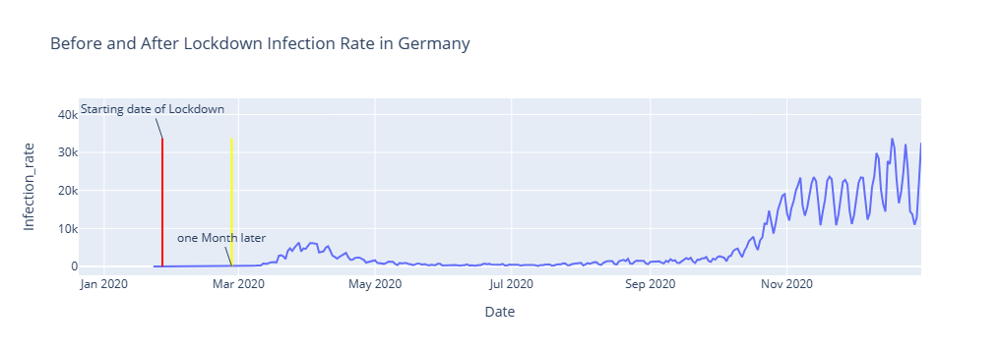

,Date,Country,Confirmed,Recovered,Deaths,Infection_rate
54672,2020-01-22,Germany,0,0,0,NaN
54673,2020-01-23,Germany,0,0,0,0.0
54674,2020-01-24,Germany,0,0,0,0.0
54675,2020-01-25,Germany,0,0,0,0.0
54676,2020-01-26,Germany,0,0,0,0.0


In [59]:
#calling the function
data_country, figure=lockdown_infection(data3, start_date, one_month, 'Germany')
data_country.head()

## During COVID-19 Death Rate Lockdown in Germany

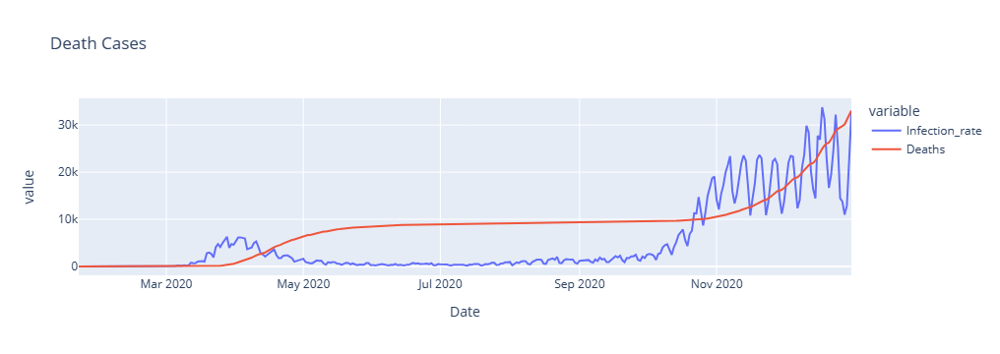

In [60]:
#plot the deaths in line chart
px.line(data_country, x='Date', y=['Infection_rate','Deaths'], title='Death Cases')

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\1023845504.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\1023845504.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\1023845504.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://panda

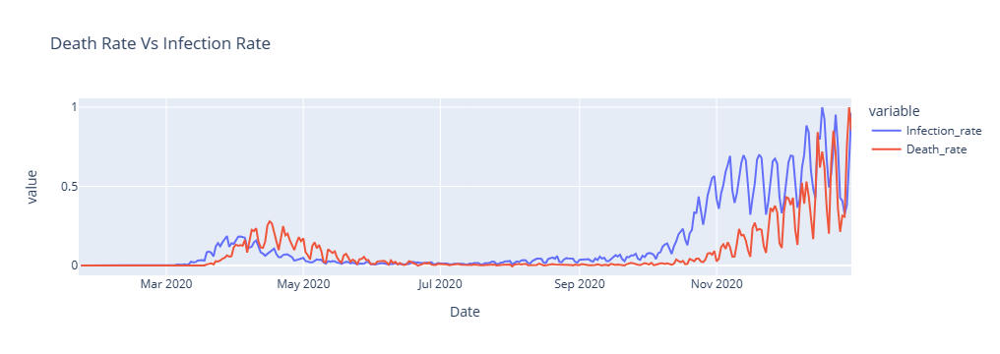

In [61]:
#calculate the death rate 
data_country['Death_rate']=data_country['Deaths'].diff()

#normalize the both columns between 0-1
data_country['Infection_rate'] = data_country['Infection_rate']/data_country['Infection_rate'].max()
data_country['Death_rate'] = data_country['Death_rate']/data_country['Death_rate'].max()

#plot the normalized data in line
px.line(data_country, x='Date', y=['Infection_rate','Death_rate'], title='Death Rate Vs Infection Rate')

## During COVID-19 Infection Rate Lockdown in China

In [62]:
def date_conversion(data, year):
    '''Used to convert the whole data frame into specific parameters as we require
    Input:
          data- dataframe
          year- int     
    Output: dataframe'''
    df=data.copy()
    import datetime as dt
    df['Date']=pd.to_datetime(df['Date'],format="%Y-%m-%d")
    df['year']=df['Date'].dt.year
    df = df[df['year']== year]
    df['Date']=df['Date'].astype('str')
    result = df.drop('year',axis=1)
    return result

In [63]:
#define the dates for lockdown
start_date = '2020-1-23'
one_month = '2020-2-23'

#calling the function
data2=data.copy()
data3=date_conversion(data2, 2020)
data3['Infection_rate']=data3.Confirmed.diff()

In [64]:
#display the information
data3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 68310 entries, 0 to 161096
Data columns (total 6 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Date            68310 non-null  object 
 1   Country         68310 non-null  object 
 2   Confirmed       68310 non-null  int64  
 3   Recovered       68310 non-null  int64  
 4   Deaths          68310 non-null  int64  
 5   Infection_rate  68309 non-null  float64
dtypes: float64(1), int64(3), object(2)
memory usage: 3.6+ MB


In [65]:
def lockdown_infection(dataset, start, one_months, country):
    ''' Calculating the Infection rate for defined country and plot the visuals 
    with some parameters like start date and certain days of lockdown'''
    
    df = dataset[dataset['Country'] == country]
    df['Infection_rate'] = df['Confirmed'].diff()
    #adding a country into title
    titles= 'Before and After Lockdown Infection Rate in '+ country
    #plot line graph
    fig = px.line(df, x='Date', y='Infection_rate', title=titles)
    #adding a line with start dates
    fig.add_shape( dict( type="line", 
                         x0=start,
                         y0=0, 
                         x1=start, 
                         y1=df['Infection_rate'].max(),
                        line=dict(color="red", width=2)))
    #adding label to the lines
    fig.add_annotation( dict( x= start, y= df['Infection_rate'].max(), text="Starting date of Lockdown"))
    #adding a line with after certain period of dates
    fig.add_shape( dict( type="line", x0=one_months,
                         y0=0, x1=one_months, y1=df['Infection_rate'].max(),
                        line= dict(color="yellow", width=2)))
     #adding label to the lines
    fig.add_annotation( dict( x= one_months, y=0, text="one Month later"))
    return df, fig.show()

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\1953854773.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



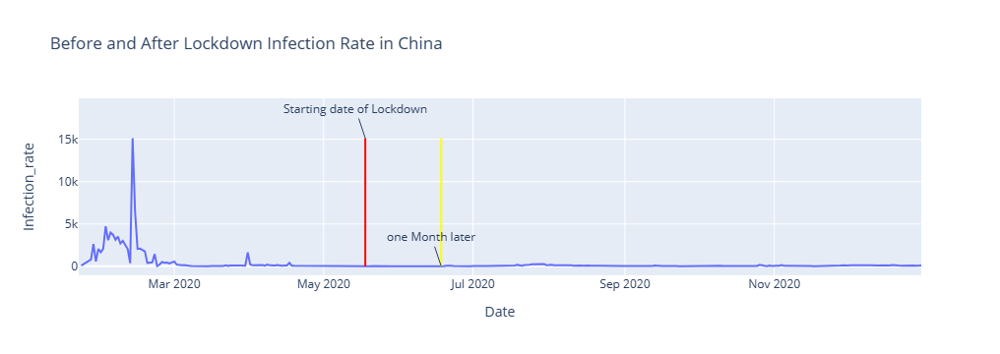

,Date,Country,Confirmed,Recovered,Deaths,Infection_rate
30192,2020-01-22,China,548,28,17,NaN
30193,2020-01-23,China,643,30,18,95.0
30194,2020-01-24,China,920,36,26,277.0
30195,2020-01-25,China,1406,39,42,486.0
30196,2020-01-26,China,2075,49,56,669.0


In [73]:
#calling the function
data_country, figure=lockdown_infection(data3, start_date, one_month, 'China')
data_country.head()

## During COVID-19 Death Rate Lockdown in China

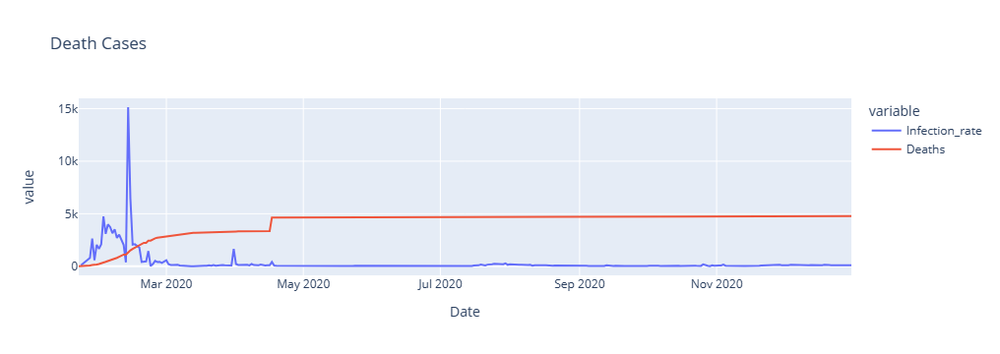

In [74]:
#plot the deaths in line chart
px.line(data_country, x='Date', y=['Infection_rate','Deaths'], title='Death Cases')

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\1023845504.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\1023845504.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\1023845504.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://panda

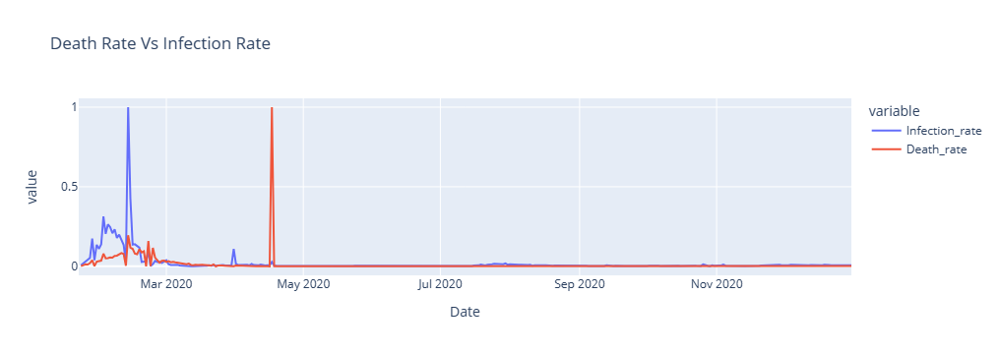

In [75]:
#calculate the death rate 
data_country['Death_rate']=data_country['Deaths'].diff()

#normalize the both columns between 0-1
data_country['Infection_rate'] = data_country['Infection_rate']/data_country['Infection_rate'].max()
data_country['Death_rate'] = data_country['Death_rate']/data_country['Death_rate'].max()

#plot the normalized data in line
px.line(data_country, x='Date', y=['Infection_rate','Death_rate'], title='Death Rate Vs Infection Rate')

## During COVID-19 Infection Rate Lockdown in Italy

In [76]:
def date_conversion(data, year):
    '''Used to convert the whole data frame into specific parameters as we require
    Input:
          data- dataframe
          year- int     
    Output: dataframe'''
    df=data.copy()
    import datetime as dt
    df['Date']=pd.to_datetime(df['Date'],format="%Y-%m-%d")
    df['year']=df['Date'].dt.year
    df = df[df['year']== year]
    df['Date']=df['Date'].astype('str')
    result = df.drop('year',axis=1)
    return result

In [77]:
#define the dates for lockdown
start_date = '2020-5-18'
one_month = '2020-6-18'

#calling the function
data2=data.copy()
data3=date_conversion(data2, 2020)
data3['Infection_rate']=data3.Confirmed.diff()

In [78]:
#display the information
data3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 68310 entries, 0 to 161096
Data columns (total 6 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Date            68310 non-null  object 
 1   Country         68310 non-null  object 
 2   Confirmed       68310 non-null  int64  
 3   Recovered       68310 non-null  int64  
 4   Deaths          68310 non-null  int64  
 5   Infection_rate  68309 non-null  float64
dtypes: float64(1), int64(3), object(2)
memory usage: 3.6+ MB


In [79]:
def lockdown_infection(dataset, start, one_months, country):
    ''' Calculating the Infection rate for defined country and plot the visuals 
    with some parameters like start date and certain days of lockdown'''
    
    df = dataset[dataset['Country'] == country]
    df['Infection_rate'] = df['Confirmed'].diff()
    #adding a country into title
    titles= 'Before and After Lockdown Infection Rate in '+ country
    #plot line graph
    fig = px.line(df, x='Date', y='Infection_rate', title=titles)
    #adding a line with start dates
    fig.add_shape( dict( type="line", 
                         x0=start,
                         y0=0, 
                         x1=start, 
                         y1=df['Infection_rate'].max(),
                        line=dict(color="red", width=2)))
    #adding label to the lines
    fig.add_annotation( dict( x= start, y= df['Infection_rate'].max(), text="Starting date of Lockdown"))
    #adding a line with after certain period of dates
    fig.add_shape( dict( type="line", x0=one_months,
                         y0=0, x1=one_months, y1=df['Infection_rate'].max(),
                        line= dict(color="yellow", width=2)))
     #adding label to the lines
    fig.add_annotation( dict( x= one_months, y=0, text="one Month later"))
    return df, fig.show()

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\1953854773.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



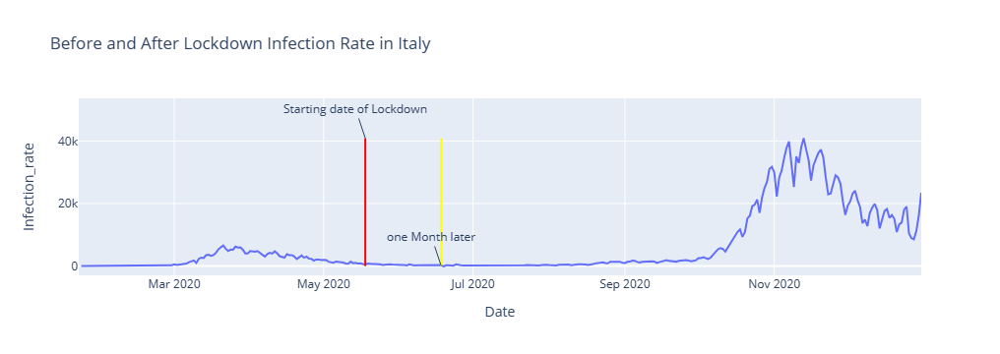

,Date,Country,Confirmed,Recovered,Deaths,Infection_rate
70176,2020-01-22,Italy,0,0,0,NaN
70177,2020-01-23,Italy,0,0,0,0.0
70178,2020-01-24,Italy,0,0,0,0.0
70179,2020-01-25,Italy,0,0,0,0.0
70180,2020-01-26,Italy,0,0,0,0.0


In [80]:
#calling the function
data_country, figure=lockdown_infection(data3, start_date, one_month, 'Italy')
data_country.head()

## During COVID-19 Death Rate Lockdown in Italy

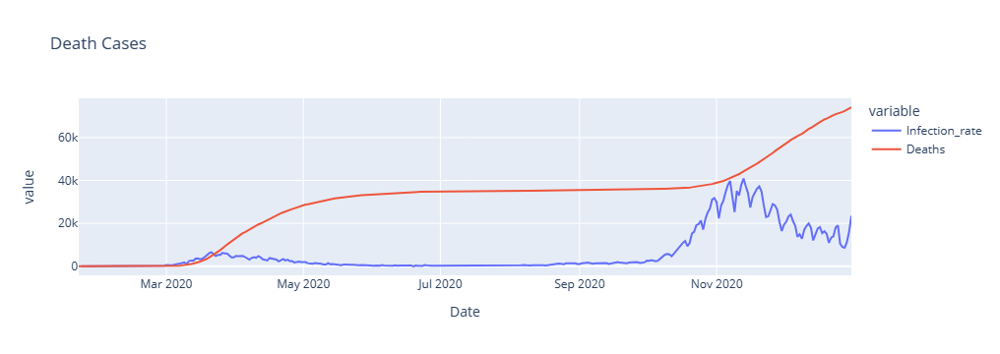

In [81]:
#plot the deaths in line chart
px.line(data_country, x='Date', y=['Infection_rate','Deaths'], title='Death Cases')

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\1023845504.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\1023845504.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\KirubaSagar\AppData\Local\Temp\ipykernel_10184\1023845504.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://panda

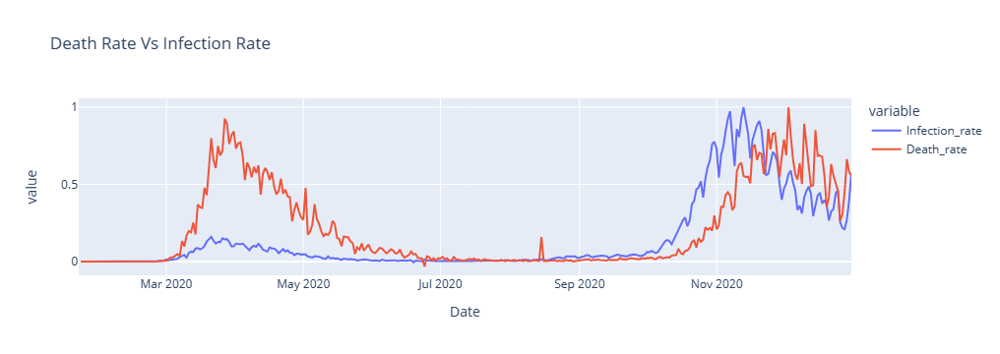

In [82]:
#calculate the death rate 
data_country['Death_rate']=data_country['Deaths'].diff()

#normalize the both columns between 0-1
data_country['Infection_rate'] = data_country['Infection_rate']/data_country['Infection_rate'].max()
data_country['Death_rate'] = data_country['Death_rate']/data_country['Death_rate'].max()

#plot the normalized data in line
px.line(data_country, x='Date', y=['Infection_rate','Death_rate'], title='Death Rate Vs Infection Rate')